### Student Information
Name: 林君騰

Student ID: 711233125

GitHub ID: Teng5488

Kaggle name: Chun Teng Lin

Kaggle private scoreboard snapshot: 

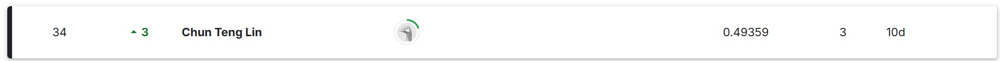

---

### Instructions

1. First: __This part is worth 30% of your grade.__ Do the **take home exercises** in the [DM2024-Lab2-master Repo](https://github.com/didiersalazar/DM2024-Lab2-Master). You may need to copy some cells from the Lab notebook to this notebook. 


2. Second: __This part is worth 30% of your grade.__ Participate in the in-class [Kaggle Competition](https://www.kaggle.com/competitions/dm-2024-isa-5810-lab-2-homework) regarding Emotion Recognition on Twitter by this link: https://www.kaggle.com/competitions/dm-2024-isa-5810-lab-2-homework. The scoring will be given according to your place in the Private Leaderboard ranking: 
    - **Bottom 40%**: Get 20% of the 30% available for this section.

    - **Top 41% - 100%**: Get (0.6N + 1 - x) / (0.6N) * 10 + 20 points, where N is the total number of participants, and x is your rank. (ie. If there are 100 participants and you rank 3rd your score will be (0.6 * 100 + 1 - 3) / (0.6 * 100) * 10 + 20 = 29.67% out of 30%.)   
    Submit your last submission **BEFORE the deadline (Nov. 26th, 11:59 pm, Tuesday)**. Make sure to take a screenshot of your position at the end of the competition and store it as '''pic0.png''' under the **img** folder of this repository and rerun the cell **Student Information**.
    

3. Third: __This part is worth 30% of your grade.__ A report of your work developing the model for the competition (You can use code and comment on it). This report should include what your preprocessing steps, the feature engineering steps and an explanation of your model. You can also mention different things you tried and insights you gained. 


4. Fourth: __This part is worth 10% of your grade.__ It's hard for us to follow if your code is messy :'(, so please **tidy up your notebook**.


Upload your files to your repository then submit the link to it on the corresponding e-learn assignment.

Make sure to commit and save your changes to your repository __BEFORE the deadline (Nov. 26th, 11:59 pm, Tuesday)__. 

---

In [2]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [ ]:
import json
import pandas as pd

with open('tweets_DM.json', 'r', encoding='utf-8') as file:
    tweets_data = file.readlines()

tweets = []
for tweet in tweets_data:
    tweet_json = json.loads(tweet) 
    tweet_id = tweet_json['_source']['tweet']['tweet_id']
    text = tweet_json['_source']['tweet']['text']
    hashtags = tweet_json['_source']['tweet'].get('hashtags', [])  
    tweets.append({'tweet_id': tweet_id, 'text': text, 'hashtags': hashtags})

tweets_df = pd.DataFrame(tweets)


In [ ]:
import json
import pandas as pd

emotions_df = pd.read_csv('emotion.csv')
merged_df = pd.merge(tweets_df, emotions_df, on='tweet_id', how='left')


In [ ]:
import json
import pandas as pd

identification_df = pd.read_csv('data_identification.csv')
merged_df = pd.merge(merged_df, identification_df, on='tweet_id', how='left')

In [ ]:
import re
import string
import pandas as pd
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS


lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english')).union(set(ENGLISH_STOP_WORDS))

def preprocess_text(text):
    text = text.lower()
    text = re.sub(f"[{re.escape(string.punctuation)}]", "", text)
    text = ' '.join([word for word in text.split() if word not in stop_words])
    text = ' '.join([lemmatizer.lemmatize(word) for word in text.split()])
    return text

merged_df['text'] = merged_df['text'].apply(preprocess_text)


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from transformers import RobertaTokenizer

df_train = merged_df[merged_df['identification'] == 'train']
df_test = merged_df[merged_df['identification'] == 'test']

label_encoder = LabelEncoder()
df_train['emotion'] = label_encoder.fit_transform(df_train['emotion'].astype(str))

df_train, df_val = train_test_split(df_train, test_size=0.2, random_state=42)

model_name = 'roberta-base'
tokenizer = RobertaTokenizer.from_pretrained(model_name)

train_encodings = tokenizer(df_train['text'].tolist(), max_length=128, truncation=True, 
                            padding='max_length', return_tensors='pt')
val_encodings = tokenizer(df_val['text'].tolist(), max_length=128, truncation=True, 
                          padding='max_length', return_tensors='pt')
test_encodings = tokenizer(df_test['text'].tolist(), max_length=128, truncation=True, 
                           padding='max_length', return_tensors='pt')

train_labels = torch.tensor(df_train['emotion'].values)
val_labels = torch.tensor(df_val['emotion'].values)



C:\Users\User\AppData\Local\Temp\ipykernel_9948\65521842.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train['emotion'] = label_encoder.fit_transform(df_train['emotion'].astype(str))


In [10]:
class EmotionDataset(Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        input_ids = self.encodings['input_ids'][idx]
        attention_mask = self.encodings['attention_mask'][idx]
        labels = torch.tensor(self.labels[idx], dtype=torch.long)
        return input_ids, attention_mask, labels



In [ ]:
train_dataset = EmotionDataset(train_encodings, train_labels)
val_dataset = EmotionDataset(val_encodings, val_labels)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)


In [ ]:
import torch
import torch.nn as nn
from transformers import RobertaModel

class EmotionClassifier(nn.Module):
    def __init__(self, model_name, num_labels):
        super(EmotionClassifier, self).__init__()
        self.roberta = RobertaModel.from_pretrained(model_name)
        self.classifier = nn.Linear(self.roberta.config.hidden_size, num_labels)

    def forward(self, input_ids, attention_mask):
        outputs = self.roberta(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs[1]
        logits = self.classifier(pooled_output)
        return logits

model_name = 'roberta-base'
num_labels = len(df_train['emotion'].unique())
model = EmotionClassifier(model_name, num_labels)


Some weights of RobertaModel were not initialized from the model checkpoint at roberta-base and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import torch
import torch.nn as nn
from torchmetrics import Accuracy, F1Score


device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

model = EmotionClassifier(model_name, num_labels).to(device)
optimizer = torch.optim.AdamW(model.parameters(), lr=3e-5)
criterion = nn.CrossEntropyLoss()

acc = Accuracy(task='multiclass', num_classes=num_labels).to(device)
f1 = F1Score(task='multiclass', num_classes=num_labels, average='macro').to(device)

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-base and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
from sklearn.metrics import f1_score

def calculate_accuracy(preds, labels):
    _, preds_max = torch.max(preds, 1)
    correct = (preds_max == labels).sum().item()
    accuracy = correct / labels.size(0)
    return accuracy

def calculate_f1(preds, labels):
    _, preds_max = torch.max(preds, 1)
    f1 = f1_score(labels.cpu().numpy(), preds_max.cpu().numpy(), average='weighted')
    return f1


In [ ]:
import torch
from tqdm import tqdm
from sklearn.metrics import accuracy_score, f1_score

def acc(logits, labels):
    preds = torch.argmax(logits, dim=1)
    return accuracy_score(labels.cpu().numpy(), preds.cpu().numpy())

def f1(logits, labels):
    preds = torch.argmax(logits, dim=1)
    return f1_score(labels.cpu().numpy(), preds.cpu().numpy(), average='weighted')

epochs = 3
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

best_val_acc = 0  

for epoch in range(epochs):
    model.train()
    bar_train = tqdm(train_loader, desc=f'Training Epoch {epoch + 1}/{epochs}')
    for batch in bar_train:
        input_ids, attention_mask, labels = [x.to(device) for x in batch]

        optimizer.zero_grad()  
        logits = model(input_ids, attention_mask)  
        loss = criterion(logits, labels)  
        loss.backward()  
        optimizer.step()  

        train_acc = acc(logits, labels)
        train_f1 = f1(logits, labels)
        bar_train.set_postfix(loss=loss.item(), acc=train_acc, f1=train_f1)

    model.eval()
    bar_val = tqdm(val_loader, desc=f'Validation Epoch {epoch + 1}/{epochs}')
    val_losses = []
    val_accs = []
    val_f1s = []

    with torch.no_grad(): 
        for batch in bar_val:
            input_ids, attention_mask, labels = [x.to(device) for x in batch]
            logits = model(input_ids, attention_mask)
            loss = criterion(logits, labels)

            val_loss = loss.item()
            val_acc = acc(logits, labels)
            val_f1 = f1(logits, labels)

            val_losses.append(val_loss)
            val_accs.append(val_acc)
            val_f1s.append(val_f1)

            bar_val.set_postfix(loss=val_loss, acc=val_acc, f1=val_f1)

    avg_val_loss = sum(val_losses) / len(val_losses)
    avg_val_acc = sum(val_accs) / len(val_accs)
    avg_val_f1 = sum(val_f1s) / len(val_f1s)

    print(f"Epoch {epoch + 1}/{epochs}:")
    print(f"  Train Loss: {loss.item():.4f}, Train Acc: {train_acc:.4f}, Train F1: {train_f1:.4f}")
    print(f"  Val Loss: {avg_val_loss:.4f}, Val Acc: {avg_val_acc:.4f}, Val F1: {avg_val_f1:.4f}")

    if avg_val_acc > best_val_acc:
        best_val_acc = avg_val_acc
        torch.save(model.state_dict(), 'best_model_1125.pth')
        print(f"Best model saved with val accuracy: {best_val_acc:.4f}")
        


Training Epoch 1/3:   0%|          | 0/18195 [00:00<?, ?it/s]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(self.labels[idx], dtype=torch.long)
c:\Users\User\anaconda3\Lib\site-packages\transformers\models\roberta\modeling_roberta.py:370: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  attn_output = torch.nn.functional.scaled_dot_product_attention(
Training Epoch 1/3:   0%|          | 1/18195 [00:00<3:40:10,  1.38it/s, acc=0.0469, f1=0.0042, loss=2.12]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requi

Epoch 1/3:
  Train Loss: 1.1404, Train Acc: 0.5882, Train F1: 0.4940
  Val Loss: 1.0975, Val Acc: 0.6017, Val F1: 0.5859
Best model saved with val accuracy: 0.6017


Training Epoch 2/3:   0%|          | 0/18195 [00:00<?, ?it/s]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(self.labels[idx], dtype=torch.long)
Training Epoch 2/3:   0%|          | 1/18195 [00:00<2:00:23,  2.52it/s, acc=0.578, f1=0.577, loss=0.985]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(self.labels[idx], dtype=torch.long)
Training Epoch 2/3:   0%|          | 2/18195 [00:00<1:13:21,  4.13it/s, acc=0.656, f1=0.647, loss=0.822]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy 

Epoch 2/3:
  Train Loss: 1.2118, Train Acc: 0.6176, Train F1: 0.5753
  Val Loss: 1.0704, Val Acc: 0.6104, Val F1: 0.5987
Best model saved with val accuracy: 0.6104


Training Epoch 3/3:   0%|          | 0/18195 [00:00<?, ?it/s]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(self.labels[idx], dtype=torch.long)
Training Epoch 3/3:   0%|          | 1/18195 [00:00<2:07:54,  2.37it/s, acc=0.688, f1=0.684, loss=0.903]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(self.labels[idx], dtype=torch.long)
Training Epoch 3/3:   0%|          | 2/18195 [00:00<1:16:18,  3.97it/s, acc=0.688, f1=0.666, loss=0.929]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy 

Epoch 3/3:
  Train Loss: 1.1381, Train Acc: 0.5588, Train F1: 0.5451
  Val Loss: 1.0565, Val Acc: 0.6187, Val F1: 0.6097
Best model saved with val accuracy: 0.6187


In [ ]:
torch.save(model.state_dict(), 'best_model_1125.pth')


In [ ]:
import json
import pandas as pd

emotions_df = pd.read_csv('emotion.csv')
merged_df = pd.merge(tweets_df, emotions_df, on='tweet_id', how='left')
identification_df = pd.read_csv('data_identification.csv')
merged_df = pd.merge(merged_df, identification_df, on='tweet_id', how='left')
df_test = merged_df[merged_df['identification'] == 'test']

test_encodings = tokenizer(df_test['text'].tolist(), max_length=128, truncation=True, padding='max_length', return_tensors='pt')
test_encodings


{'input_ids': tensor([[    0, 33295,  8009,  ...,     1,     1,     1],
        [    0,   113, 18823,  ...,     1,     1,     1],
        [    0,  1779,   109,  ...,     1,     1,     1],
        ...,
        [    0,  1779,    47,  ...,     1,     1,     1],
        [    0,   100, 24909,  ...,     1,     1,     1],
        [    0,  1039, 22011,  ...,     1,     1,     1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]])}

In [ ]:
test_labels = torch.zeros(len(test_encodings['input_ids']))  
test_dataset = EmotionDataset(test_encodings, test_labels)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

model.eval()
predictions = []
with torch.no_grad():
    for batch in tqdm(test_loader, desc="Predicting on Test Set"):
        input_ids, attention_mask, _ = [x.to(device) for x in batch]  
        logits = model(input_ids, attention_mask)
        preds = torch.argmax(logits, dim=1) 
        predictions.extend(preds.cpu().numpy())  


predicted_emotions = label_encoder.inverse_transform(predictions)
df_test['predicted_emotion'] = predicted_emotions
df_test[['text', 'predicted_emotion']].to_csv('test_predictions_1126.csv', index=False)


Predicting on Test Set:   0%|          | 0/6438 [00:00<?, ?it/s]C:\Users\User\AppData\Local\Temp\ipykernel_9948\2938484917.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(self.labels[idx], dtype=torch.long)
Predicting on Test Set: 100%|██████████| 6438/6438 [04:31<00:00, 23.71it/s]
C:\Users\User\AppData\Local\Temp\ipykernel_9948\330991333.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['predicted_emotion'] = predicted_emotions


In [ ]:

df_test['id'] = df_test['tweet_id'].astype(str)
df_test['emotion'] = df_test['predicted_emotion'].astype(str)
df_test[['id', 'emotion']].to_csv('test_predictions_with_id_1126.csv', index=False)


C:\Users\User\AppData\Local\Temp\ipykernel_9948\3108201708.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['id'] = df_test['tweet_id'].astype(str)
C:\Users\User\AppData\Local\Temp\ipykernel_9948\3108201708.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test['emotion'] = df_test['predicted_emotion'].astype(str)
